# Custom Environment: Final Haunted Mansion
------

Building on top of the intermediate environment by making ghosts move after each action the agent takes.

Rules of the environemnt are the same with some modifications:

    - There are 4 discrete actions the agent can take: up. down, left and right
    - The game terminates when the agent has reached the exit door of the haunted mansion
    - The agent represents the trick-or-treater
    - The agent receives a reward of + 10 when they have reached the exit door
    - For each timestep where the agent is not at the target location, they receive a penalty of - 0.75
    - If the agent encounters a ghost along their path they receive a penalty of -5, if they encounter a candy they recieve reward of +3
    - Ghosts locations are randomly set at the start of each episode.

## Set Up
-----

In [1]:
import numpy as np
import pandas as pd
import gymnasium as gym
import pygame
import matplotlib.pyplot as plt
from final_env import Final_Haunted_Mansion
import random

In [2]:
# Register the environment
gym.register(
    id='Haunted_Mansion-v3',
    entry_point = 'final_env:Final_Haunted_Mansion'  
)

## Using Stable Baselines 3
-----

In [3]:
# To inspect later 
log_path = ('../../Training/Logs/Final_Env/')
model_path = ('../../Training/Saved Models/Final_Env/')

In [4]:
from stable_baselines3.common.vec_env import DummyVecEnv
from stable_baselines3 import DQN
from stable_baselines3.common.vec_env import VecMonitor

# Create the environment
env = gym.make('Haunted_Mansion-v3', render_mode= None)

# Create the environment and vectorise it using DummyVecEnv
v_env = DummyVecEnv([lambda: gym.make('Haunted_Mansion-v3', render_mode = None, step_penalty = 0.75) for i in range(5)])
# Using VecMonitor since have multiple environments 
learn_env = VecMonitor(v_env,filename=log_path) 

**Comment:**

- Step Penalty =  - 0.75

- Higher than Q-learning since DQN is more stable.

In [5]:
# Define the DQN model
model = DQN(
    policy = "MultiInputPolicy",    # Since obs is a dict
    env = learn_env,                # Train in 'wrapped' environment
    buffer_size = 150_000,          # Size of Replay Buffer 
    batch_size=256,                 # Batch size to proceess
    learning_rate=0.0005 ,          # Ensure smoothness 
    target_update_interval=10_000,  # Update to Target Network weights every 10_000 steps
    exploration_final_eps=0.1,      # Epsilon decays to 0.1, 10% of time agent chooses exploration
    exploration_fraction=0.7,       # Epsilon decays over 70% of the training
    verbose=1
)
# Train the model 
model.learn(total_timesteps=1_250_000) 

# Save the model
model.save(path = model_path)

Using cpu device
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 39.5     |
|    ep_rew_mean      | -63.9    |
|    exploration_rate | 1        |
| time/               |          |
|    episodes         | 4        |
|    fps              | 7020     |
|    time_elapsed     | 0        |
|    total_timesteps  | 365      |
| train/              |          |
|    learning_rate    | 0.0005   |
|    loss             | 1.02     |
|    n_updates        | 13       |
----------------------------------
----------------------------------
| rollout/            |          |
|    ep_len_mean      | 50.8     |
|    ep_rew_mean      | -58.8    |
|    exploration_rate | 0.999    |
| time/               |          |
|    episodes         | 8        |
|    fps              | 9227     |
|    time_elapsed     | 0        |
|    total_timesteps  | 770      |
| train/              |          |
|    learning_rate    | 0.0005   |
|    loss             | 0.931    |
|  

### Inspecting the network

In [6]:
print(model.policy)

MultiInputPolicy(
  (q_net): QNetwork(
    (features_extractor): CombinedExtractor(
      (extractors): ModuleDict(
        (agent): Flatten(start_dim=1, end_dim=-1)
        (candies): Flatten(start_dim=1, end_dim=-1)
        (ghosts): Flatten(start_dim=1, end_dim=-1)
        (target): Flatten(start_dim=1, end_dim=-1)
      )
    )
    (q_net): Sequential(
      (0): Linear(in_features=14, out_features=64, bias=True)
      (1): ReLU()
      (2): Linear(in_features=64, out_features=64, bias=True)
      (3): ReLU()
      (4): Linear(in_features=64, out_features=4, bias=True)
    )
  )
  (q_net_target): QNetwork(
    (features_extractor): CombinedExtractor(
      (extractors): ModuleDict(
        (agent): Flatten(start_dim=1, end_dim=-1)
        (candies): Flatten(start_dim=1, end_dim=-1)
        (ghosts): Flatten(start_dim=1, end_dim=-1)
        (target): Flatten(start_dim=1, end_dim=-1)
      )
    )
    (q_net): Sequential(
      (0): Linear(in_features=14, out_features=64, bias=True)


----
**Comment:**

- Instead of representing the states as a grid of every possible state (like in Q-Tables), the network breaks the environment state down into features:
       
        - agents position (x,y)
        - position of all three ghosts (x,y)
        - position of the two candies (x,y)
        - position of the door (target) (x.y)
        
- Using the Combined Extractor the network flattens the position of all items in environment into a single feature vector of size 14:

        Agent Position:
        - Node 1: x coordinate of the agent.
        - Node 2: y coordinate of the agent.

        Ghosts' Positions (e.g., three ghosts):
        - Node 3: x coordinate of Ghost 1.
        - Node 4: y coordinate of Ghost 1.
        - Node 5: x coordinate of Ghost 2.
        - Node 6: y coordinate of Ghost 2.
        - Node 7: x coordinate of Ghost 3.
        - Node 8: y coordinate of Ghost 3.

        Candies' Positions (e.g., two candies):
        - Node 9: x coordinate of Candy 1.
        - Node 10: y coordinate of Candy 1.
        - Node 11: x coordinate of Candy 2.
        - Node 12: y coordinate of Candy 2.

        Target Position:
        - Node 13: x coordinate of the target (door).
        - Node 14: y coordinate of the target.

- The advanatage of representing states like this instead of grid states (like in Q-learning) is that feature vectors are scalable and even if there was an explosion in state space, there would not be an explosion in input nodes to the network.

- There are two hidden layers, each with 64 nuerons (nodes) with ReLu activation.

- The output layer as 4 nodes, each representing action from action space (UP,DOWN,LEFT,RIGHT).

### Training Logs

In [7]:
# Path to monitor.csv file
monitor_file = ('../../Training/Logs/Final_Env/monitor.csv') 

In [8]:
# Read the CSV file using pandas
df = pd.read_csv(monitor_file,skiprows=1)

In [9]:
episode_rewards = df['r'].values  # 'r' column contains the reward per episode
episode_lengths = df['l'].values  # 'l' column contains the length of each episode
episode_time = df['t'].values 

In [10]:
# Using moving average to smooth out the noise in both rewards and episode length
smoothed_rewards = pd.Series(episode_rewards).rolling(window=100).mean()
smoothed_length = pd.Series(episode_lengths).rolling(window=100).mean()

#### Rewards

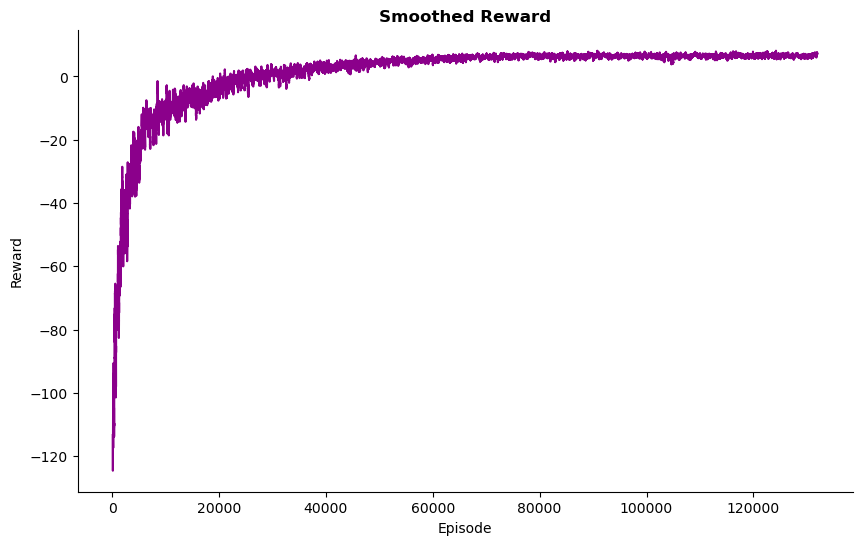

In [15]:
plt.figure(figsize=(10, 6))
plt.plot(smoothed_rewards, color='darkmagenta')
plt.xlabel('Episode')
plt.ylabel('Reward')
plt.title('Smoothed Reward', fontweight = 'bold')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()

----
**Comment:**

Early in the training, the reward for the first 20,000 episdoes vary a lot. This makes sense as this is when the agent is exploring the environment, updating its policy based on its observations. This can be seen by the steep improvement in reward per episode as the policy is updated and the agent starts to exploit the environemnt.

After 40,000 episodes, the curve begins to flatten and the rewards start to stabalise. This is a sign the agent has successfully learned the task well enough and its performance is now stable. After 50,000 episodes, the agent's performance no longer improves much suggesting the agent has reached a near optimal policy.

Overall training the agent aligned with typical patterns seen from RL agents. The agent gradually shifts from exploration to exploitation with the learning curve flattening as it reaches a near-optimal policy. 

#### Episode Lengths 

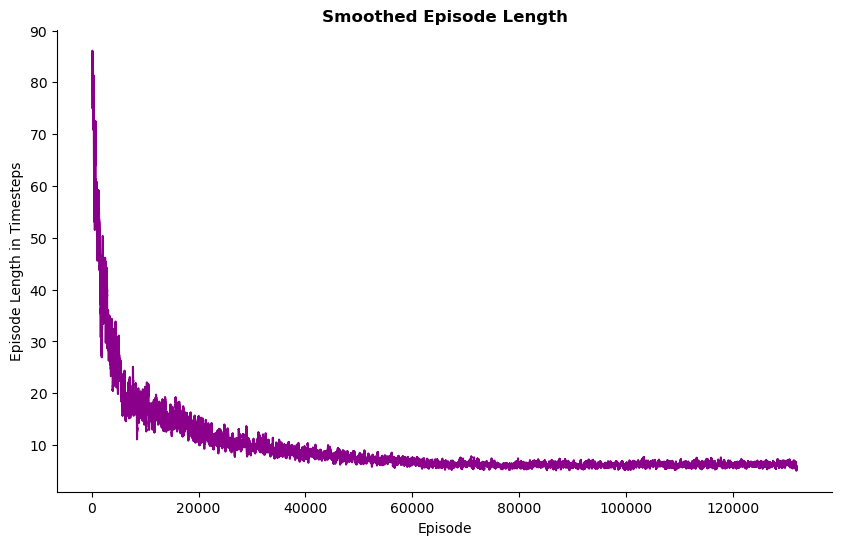

In [16]:
plt.figure(figsize=(10, 6))
plt.plot(smoothed_length, color='darkmagenta')
plt.xlabel('Episode')
plt.ylabel('Episode Length in Timesteps')
plt.title('Smoothed Episode Length', fontweight = 'bold')
plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()


-----
**Comment:**

Early in the training the agent takes a more timesteps to complete the task. This makes sense in RL as early on in the training the agent prioritises exploring its environment taking more timesteps.

As the training progresses, the agent refines its policy and begins to exploit what it has learned, leading to fewer timesteps per episode. The curve beigns to plateau around episode 40,000, the agent's policy has become more effective in completing the task, This stability in timesteps suggests the agent has learned a near-optimal path.

One noticeable difference between DQN training and Q-learning training is that DQN's train over a larger amount of episodes. This is likely due to how DQNs train using neural networks, networks require a lot of data in order to train and learn effectively.


## Testing

In [13]:
env = gym.make('Haunted_Mansion-v3',  render_mode= 'human', step_penalty = 0.75)

In [14]:
# Setting the number of episodes for testing
episodes = 20

for episode in range(episodes):
   
    # Resetting the environment to an initial state
    obs, info= env.reset()

    done = False

    score = 0
    
    while not done:
        # Get action from the Q-table
        action, states = model.predict(obs, deterministic=True)
        
        # Step through the environment using the action
        obs, reward, terminated, truncated, info = env.step(action)  


        # Update the done condition based on terminated flag (truncated is always False in this env)
        done = terminated

        # Visualise the environment after each action agent takes
        env.render()

        # Add reward received for action to total episode score
        score += reward
        
        # Delay to slow down the movement for better observation
        pygame.time.delay(300) 
    
    # After the episode ends, print the score
    print(f'Episode {episode+1} Score: {round(score,2)}')

env.close()

Episode 1 Score: 8.5
Episode 2 Score: 9.25
Episode 3 Score: 9.25
Episode 4 Score: 9.25
Episode 5 Score: 8.5
Episode 6 Score: 7.75
Episode 7 Score: 8.5
Episode 8 Score: 8.5
Episode 9 Score: 9.25
Episode 10 Score: 9.25
Episode 11 Score: 9.25
Episode 12 Score: 8.5
Episode 13 Score: 8.5
Episode 14 Score: 8.5
Episode 15 Score: 9.25
Episode 16 Score: 7.75
Episode 17 Score: 9.25
Episode 18 Score: 1.5
Episode 19 Score: 10.0
Episode 20 Score: 8.5


----
**Comment:**

**SCORE WHEN STEP PENALTY -0.75**

- High Scores (9.25–10.0): 

    - The agent performs consistently well in some episodes (e.g., Episode 3, 9, 19), showing that it effectively avoids penalties and collects rewards.

- Lower Scores (less than 7.75): 

    - Poor performance in episodes like 18 suggests the agent may have encountered ghosts frequently or failed to reach rewards.

----
**SCORE WHEN STEP PENALTY -1**

    Episode 1 Score: 7
    Episode 2 Score: 7
    Episode 3 Score: -1
    Episode 4 Score: 9
    Episode 5 Score: 0
    Episode 6 Score: 7
    Episode 7 Score: 7
    Episode 8 Score: 8
    Episode 9 Score: 7
    Episode 10 Score: 7
    Episode 11 Score: 7
    Episode 12 Score: -2
    Episode 13 Score: 7
    Episode 14 Score: 8
    Episode 15 Score: 7
    Episode 16 Score: 6
    Episode 17 Score: 8
    Episode 18 Score: 8
    Episode 19 Score: 6
    Episode 20 Score: 6

- Most scores are above 7:

    - These indicate that the agent is consistently reaching the target and likely collecting at least one candy along the way, despite the step penalty of 1.
    - It might be worth experimenting with a lower step penalty since the maximum achievable reward is +14 (door (+10) + 2 candies(+ 2)), and a high step penalty could discourage exploration.

- Scores at 6:

    - most likley cases where agent is following sub-optimal paths to the target, either long paths with no candies or encountering ghosts on way to target.

- Few cases where score is less than 0:

    - Not ideal, likley where the agent encounters a ghost and does not get a candy/takes large amount of steps.


## Appendix
-----

### Attempt at DQN

- to revisit and try again at a later date
- ran out of time for this project
- to try: 
    - re do netwrok architecture match that of the DQN from Stable Baselines 3
    - Look into feature extraction using CombinedExtractor

In [ ]:
# number of states = agent's position plus location of the three ghosts/ two candies/door
# nr_states = 7
# nr_actions = 4

In [ ]:
# def create_network (nr_states, nr_actions,learning_rate=0.001, network_name = 'Network'):

#   model = keras.Sequential(
#        [  layers.Dense(32, activation='relu', input_shape=(nr_states,)),
#           layers.Dense(32, activation='relu'),
#            # output layer, q-values not probabalities they are real numbers should be linear (to expand)
#           layers.Dense(nr_actions, activation='linear')
#        ], 
#        name = network_name
#        )

#   model.compile(optimizer=tf.keras.optimizers.legacy.Adam(learning_rate), loss='mse')  # Mean Squared Error loss

#   model.summary()

#   return model

### Step 1: Create Policy and Target Network


In [ ]:
# policy_network = create_network(nr_states = nr_states, nr_actions=nr_actions, network_name = 'Policy_Network')

Model: "Policy_Network"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32)                288       
                                                                 
 dense_1 (Dense)             (None, 32)                1056      
                                                                 
 dense_2 (Dense)             (None, 4)                 132       
                                                                 
Total params: 1,476
Trainable params: 1,476
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# target_network = create_network(nr_states = nr_states, nr_actions=nr_actions, network_name = 'Target_Network')

Model: "Target_Network"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 32)                288       
                                                                 
 dense_4 (Dense)             (None, 32)                1056      
                                                                 
 dense_5 (Dense)             (None, 4)                 132       
                                                                 
Total params: 1,476
Trainable params: 1,476
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# # Ensure target network and policy network weights are the same
# target_network.set_weights(policy_network.get_weights())

### Step 2: Initialise Experience Replay

In [ ]:
# exp_replay = []
# max_size = 1_500
# batch_size = 32
# import numpy as np

### Step 3: Set Hyperparameters

In [ ]:
# learning_rate = 0.001
# gamma = 0.99
# epsilon = 1.0

### Step 4: Training

In [ ]:
# # Training over 100,000 episodes
# episodes = 10_000
# rewards_per_episode = []

  
# for episode in range(episodes):
#     # Get initial obs from env
#     obs, info = env.reset()
#     # Initialise score to 0 for each episode
#     score = 0
#     # Initialise done to False for each episode
#     done = False
#     # Get current state of agent, reshape to 2d array (match input of network)
#     current_state = np.concatenate([ obs['agent'].flatten(), obs['ghosts'].flatten()]).reshape(1,-1)
    
#     # Get Q-values from policy network 
#     Q_values = policy_network.predict(current_state)  # Q-values are an array of shape (1, nr_actions)
#     Q_values = Q_values[0] # Flatten back to 1d array

#     while not done:
#         # Action Selection using Epsilon Greedy
#         rand_num = random.random()
#         # Use rand_num to control exploration/exploitation
#         if rand_num < epsilon:
#             action = env.action_space.sample()  
#         else:
#             # Take action where Q-value is max, using policy network
#             action = np.argmax(Q_values) 
        
#         # Use step to take action
#         obs, reward, terminated, truncated, info = env.step(action)
#         # Set next_state from obs after step
#         next_state = np.concatenate([ obs['agent'].flatten(), obs['ghosts'].flatten()]).reshape(1,-1)
#         # Store experience to be used  later in training 
#         exp_replay.append((current_state, action, reward, next_state, terminated))
        
#         score += reward
#         # Setting current_state to next_state once update is done 
#         current_state = next_state
#         # Done only True once Terminated is True (agent reaches door)
#         done = terminated 

#     # Once epsuode has ended process experiences

# # Perform training after every episode using experience replay
#     if len(exp_replay) >= batch_size:
#         batch = random.sample(exp_replay, batch_size)
        
#         for current_state, action, reward, next_state, terminated in batch:
#             # Predict target Q-values from target network
#             target_Q_values = target_network.predict(next_state)[0]
#             target_q = reward if terminated else reward + gamma * np.max(target_Q_values)

#             # Predict current Q-values from policy network
#             Q_values = policy_network.predict(current_state)[0]

#             # Update the Q-value for the taken action
#             Q_values[action] = target_q

#             # Train policy network on the updated Q-value
#             policy_network.fit(current_state, Q_values.reshape(1, -1), epochs=1, verbose=0)

#     if episode %1000 == 0:
#         # Ensure target network and policy network weights are the same
#         target_network.set_weights(policy_network.get_weights())

#     # Decay epsilon across all episodes, using max to avoid epsilon decaying all the way to 0
#     epsilon = max(0.01, 1 - (episode / episodes))
#     # Adding total score to list
#     rewards_per_episode.append(score)

    

1/1 [==============================] - 0s 9ms/step


2024-11-22 15:14:49.997464: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


1/1 [==============================] - 0s 10ms/step


KeyboardInterrupt: 

In [ ]:
!pip install keras-rl2

In [ ]:
# # Setting step penalty to 0.2, to discourage and penalise excessive steps
# # Large rewards must make penalty higher for ppo
# env = gym.make('Haunted_Mansion-v3',  render_mode= 'human')

In [ ]:
# evaluation_episodes = 10
# total_rewards = []

# for episode in range(evaluation_episodes):
#     obs, info = env.reset()
#     score = 0
#     done = False
#     current_state = np.concatenate([obs['agent'].flatten(), obs['ghosts'].flatten()]).reshape(1, -1)

#     while not done:
#         # Get Q-values from the policy network
#         Q_values = policy_network.predict(current_state)[0]
        
#         # Choose the action with the highest Q-value (no exploration)
#         action = np.argmax(Q_values)
        
#         # Take the action in the environment
#         obs, reward, terminated, truncated, info = env.step(action)
#         score += reward
        
#         # Update the current state
#         current_state = np.concatenate([obs['agent'].flatten(), obs['ghosts'].flatten()]).reshape(1, -1)
        
#         # End episode if terminated
#         done = terminated

#     # Store the total reward for the episode
#     total_rewards.append(score)

#     print(f"Episode {episode + 1}: Total Reward = {score}")

# # Calculate average reward over evaluation episodes
# average_reward = np.mean(total_rewards)
# print(f"Average Reward over {evaluation_episodes} episodes: {average_reward}")


In [ ]:
# policy_network.predict(state)

1/1 [==============================] - 0s 11ms/step


array([[ 0.46669888,  0.53129256,  0.5735119 , -0.15267281]],
      dtype=float32)